In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="sDfIWRbiccdW3QpuRqIs")
project = rf.workspace("bethaniaworkspace").project("motorcycledetection-plboa")
version = project.version(4)
dataset = version.download("yolov8-obb")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 108.4 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to MotorcycleDetection-4 in yolov8-obb:: 100%|██████████| 2796/2796 [00:00<00:00, 6358.80it/s]


In [2]:
import os

print("Dataset location:", dataset.location)
print("Folders inside:")
print(os.listdir(dataset.location))

Dataset location: /content/MotorcycleDetection-4
Folders inside:
['train', 'README.roboflow.txt', 'data.yaml', 'README.dataset.txt', 'valid', 'test']


In [3]:
import os
import yaml

# Path ke file data.yaml yang diunduh
data_yaml_path = os.path.join(dataset.location, "data.yaml")

# Baca isinya
with open(data_yaml_path, "r") as f:
    data = yaml.safe_load(f)

print(data)


{'train': 'train/images', 'val': 'valid/images', 'test': 'test/images', 'names': {0: 'motorBebek', 1: 'motorListrik', 2: 'motorMatic', 3: 'motorSport', 4: 'motorTrail'}}


In [4]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 53.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 65.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 34.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [5]:
from ultralytics import YOLO

# Muat model YOLOv8n (versi ringan, bisa diganti ke yolov8s, m, l)
model = YOLO("yolov8n.pt")

# Training
model.train(
    data=os.path.join(dataset.location, "data.yaml"),  # path ke data.yaml dari roboflow
    epochs=30,
    imgsz=640,
    batch=16,
    name="motorcycle_rf_train"
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 402MB/s]

Ultralytics 8.3.160 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/MotorcycleDetection-4/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=motorcycle_rf_train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=False, project=None, rect=False, resume=Fa

100%|██████████| 755k/755k [00:00<00:00, 133MB/s]

Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 129 layers, 3,011,823 parameters, 3,011,807 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 330MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 110.0±193.7 MB/s, size: 57.8 KB)


train: Scanning /content/MotorcycleDetection-4/train/labels... 1238 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1238/1238 [00:01<00:00, 795.38it/s]


train: New cache created: /content/MotorcycleDetection-4/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 9.2±4.6 MB/s, size: 45.9 KB)


val: Scanning /content/MotorcycleDetection-4/valid/labels... 77 images, 0 backgrounds, 0 corrupt: 100%|██████████| 77/77 [00:00<00:00, 521.58it/s]

val: New cache created: /content/MotorcycleDetection-4/valid/labels.cache


Plotting labels to runs/detect/motorcycle_rf_train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/motorcycle_rf_train
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      2.02G      1.002      2.751      1.524         22        640: 100%|██████████| 78/78 [00:26<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.69it/s]

                   all         77         80      0.355      0.675      0.451      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      2.51G      1.006      2.114      1.489         16        640: 100%|██████████| 78/78 [00:23<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.32it/s]

                   all         77         80      0.392      0.637      0.555      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      2.53G     0.9951      1.933      1.484         19        640: 100%|██████████| 78/78 [00:22<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         77         80      0.463      0.725      0.589      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      2.54G      1.002      1.779      1.479         15        640: 100%|██████████| 78/78 [00:22<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]

                   all         77         80      0.485      0.752      0.633      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      2.56G     0.9806      1.658      1.456         17        640: 100%|██████████| 78/78 [00:22<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.53it/s]

                   all         77         80      0.321      0.535      0.414      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      2.57G     0.9426      1.558      1.423         19        640: 100%|██████████| 78/78 [00:23<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.46it/s]

                   all         77         80       0.58      0.559      0.556      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30       2.6G     0.9156      1.474      1.419         21        640: 100%|██████████| 78/78 [00:22<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.42it/s]

                   all         77         80      0.796      0.739      0.857      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      2.61G     0.8907      1.416      1.394         18        640: 100%|██████████| 78/78 [00:22<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.58it/s]

                   all         77         80      0.829      0.736      0.821      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      2.63G     0.8673       1.37      1.376         17        640: 100%|██████████| 78/78 [00:22<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.22it/s]

                   all         77         80      0.791      0.817       0.88      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      2.64G      0.859      1.301      1.361         19        640: 100%|██████████| 78/78 [00:21<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.92it/s]

                   all         77         80      0.789       0.88      0.884      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      2.66G     0.8436       1.28      1.339         22        640: 100%|██████████| 78/78 [00:21<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.08it/s]

                   all         77         80      0.706      0.883      0.895      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      2.67G     0.8064      1.217      1.326         17        640: 100%|██████████| 78/78 [00:22<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.89it/s]

                   all         77         80      0.839      0.832      0.912      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30       2.7G     0.8027      1.182      1.323         21        640: 100%|██████████| 78/78 [00:22<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.25it/s]

                   all         77         80      0.657      0.842      0.855       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      2.71G     0.7768      1.169      1.302         18        640: 100%|██████████| 78/78 [00:22<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.45it/s]

                   all         77         80      0.881      0.849      0.916      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      2.73G     0.7556      1.124      1.285         21        640: 100%|██████████| 78/78 [00:22<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.07it/s]


                   all         77         80      0.882      0.829      0.886       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      2.74G     0.7524      1.121      1.283         13        640: 100%|██████████| 78/78 [00:22<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.29it/s]

                   all         77         80      0.844      0.859      0.927      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      2.77G     0.7471      1.063      1.281         19        640: 100%|██████████| 78/78 [00:22<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.08it/s]

                   all         77         80      0.857      0.832      0.896      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      2.78G     0.7119      1.047      1.251         20        640: 100%|██████████| 78/78 [00:21<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.44it/s]

                   all         77         80      0.896      0.865      0.953      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30       2.8G     0.7069      1.029      1.244         20        640: 100%|██████████| 78/78 [00:22<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.31it/s]

                   all         77         80      0.838      0.902      0.955      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      2.81G     0.7018     0.9743      1.234         20        640: 100%|██████████| 78/78 [00:22<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.31it/s]

                   all         77         80      0.881      0.898      0.926      0.817


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      2.83G     0.4494     0.6992      1.211          6        640: 100%|██████████| 78/78 [00:23<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.69it/s]

                   all         77         80      0.889      0.801      0.898      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      2.85G     0.4064     0.5878      1.184          6        640: 100%|██████████| 78/78 [00:21<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.85it/s]

                   all         77         80      0.917      0.904      0.961      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      2.87G     0.3859     0.5727      1.158          7        640: 100%|██████████| 78/78 [00:20<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  4.28it/s]

                   all         77         80      0.889      0.894       0.93      0.842



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      2.88G     0.3663     0.4859      1.125          6        640: 100%|██████████| 78/78 [00:21<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.88it/s]

                   all         77         80      0.921      0.854       0.95      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30       2.9G     0.3636     0.4642      1.124          6        640: 100%|██████████| 78/78 [00:21<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.92it/s]

                   all         77         80      0.938      0.884      0.959      0.877



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      2.92G     0.3399     0.4397      1.093          6        640: 100%|██████████| 78/78 [00:20<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         77         80      0.912      0.903      0.928       0.85



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      2.93G     0.3248     0.4184       1.09          6        640: 100%|██████████| 78/78 [00:20<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.63it/s]

                   all         77         80      0.955      0.931       0.97      0.887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      2.95G     0.3114     0.3867      1.081          6        640: 100%|██████████| 78/78 [00:21<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  4.34it/s]

                   all         77         80      0.935      0.919      0.962       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      2.97G     0.2944     0.3626      1.049          6        640: 100%|██████████| 78/78 [00:20<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         77         80      0.934      0.937      0.969      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      2.98G     0.2823     0.3478      1.052          6        640: 100%|██████████| 78/78 [00:20<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.24it/s]

                   all         77         80      0.935      0.924      0.964      0.901



30 epochs completed in 0.197 hours.
Optimizer stripped from runs/detect/motorcycle_rf_train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/motorcycle_rf_train/weights/best.pt, 6.2MB

Validating runs/detect/motorcycle_rf_train/weights/best.pt...
Ultralytics 8.3.160 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.60it/s]


                   all         77         80      0.934      0.937      0.969      0.908
            motorBebek         16         16      0.928          1      0.991      0.924
          motorListrik         13         13      0.786      0.923      0.921      0.866
            motorMatic         16         16          1      0.815      0.948      0.941
            motorSport         16         16      0.972          1      0.995      0.915
            motorTrail         16         19      0.983      0.947       0.99      0.893
Speed: 0.4ms preprocess, 2.3ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to runs/detect/motorcycle_rf_train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a3fd94e40d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [7]:
# Load model hasil training
model = YOLO("runs/detect/motorcycle_rf_train/weights/best.pt")

# Gambar uji
test_images_folder = os.path.join(dataset.location, "test/images")
results = model(test_images_folder, conf=0.25, save=True)




image 1/77 /content/MotorcycleDetection-4/test/images/Image_21_png.rf.8edaba4998c3854bd56c4a8b4e2e3272.jpg: 640x640 1 motorTrail, 7.7ms
image 2/77 /content/MotorcycleDetection-4/test/images/Image_247_jpg.rf.45e5412260d57d9abc2a4aff3d2c111a.jpg: 640x640 1 motorMatic, 7.4ms
image 3/77 /content/MotorcycleDetection-4/test/images/Image_278_jpg.rf.b55e7f51139ea21fddfff92253d6e6cc.jpg: 640x640 1 motorSport, 7.4ms
image 4/77 /content/MotorcycleDetection-4/test/images/Image_283_jpg.rf.fbea2a4b998002488c89ef30d343290b.jpg: 640x640 1 motorSport, 7.4ms
image 5/77 /content/MotorcycleDetection-4/test/images/Image_28_jpg.rf.e8856e25fd05b71c43bbb9a1eb2e6069.jpg: 640x640 1 motorSport, 7.5ms
image 6/77 /content/MotorcycleDetection-4/test/images/Image_306_jpg.rf.09040e13a86de3ff3c2a08e8b569e90f.jpg: 640x640 1 motorListrik, 7.4ms
image 7/77 /content/MotorcycleDetection-4/test/images/Image_34_JPG.rf.252e73a385c568addec56812f7c9b77d.jpg: 640x640 1 motorMatic, 1 motorSport, 7.4ms
image 8/77 /content/Motorcy


image 1/77 /content/MotorcycleDetection-4/test/images/Image_21_png.rf.8edaba4998c3854bd56c4a8b4e2e3272.jpg: 640x640 1 motorTrail, 13.5ms
image 2/77 /content/MotorcycleDetection-4/test/images/Image_247_jpg.rf.45e5412260d57d9abc2a4aff3d2c111a.jpg: 640x640 1 motorMatic, 27.6ms
image 3/77 /content/MotorcycleDetection-4/test/images/Image_278_jpg.rf.b55e7f51139ea21fddfff92253d6e6cc.jpg: 640x640 1 motorSport, 35.4ms
image 4/77 /content/MotorcycleDetection-4/test/images/Image_283_jpg.rf.fbea2a4b998002488c89ef30d343290b.jpg: 640x640 1 motorSport, 32.4ms
image 5/77 /content/MotorcycleDetection-4/test/images/Image_28_jpg.rf.e8856e25fd05b71c43bbb9a1eb2e6069.jpg: 640x640 1 motorSport, 11.1ms
image 6/77 /content/MotorcycleDetection-4/test/images/Image_306_jpg.rf.09040e13a86de3ff3c2a08e8b569e90f.jpg: 640x640 1 motorListrik, 12.5ms
image 7/77 /content/MotorcycleDetection-4/test/images/Image_34_JPG.rf.252e73a385c568addec56812f7c9b77d.jpg: 640x640 1 motorMatic, 1 motorSport, 66.3ms
image 8/77 /content/

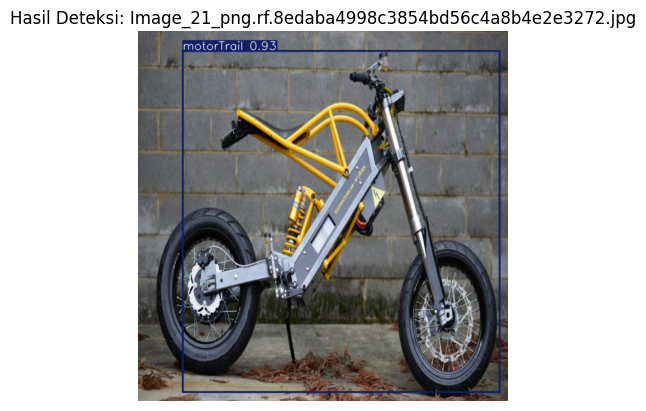

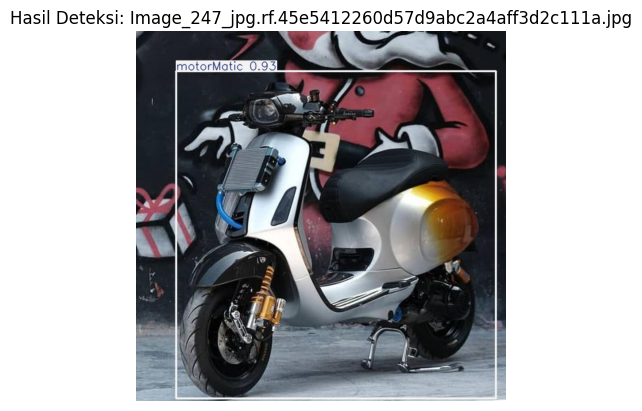

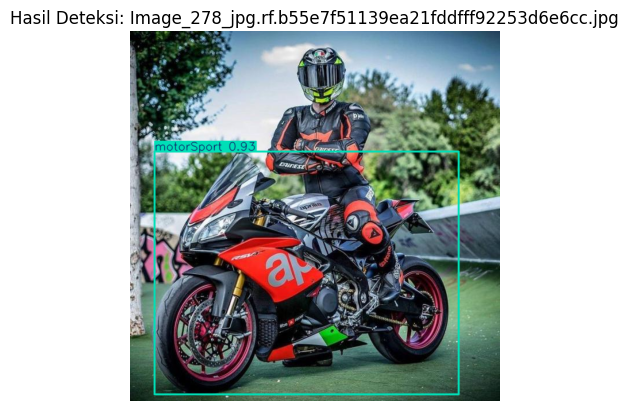

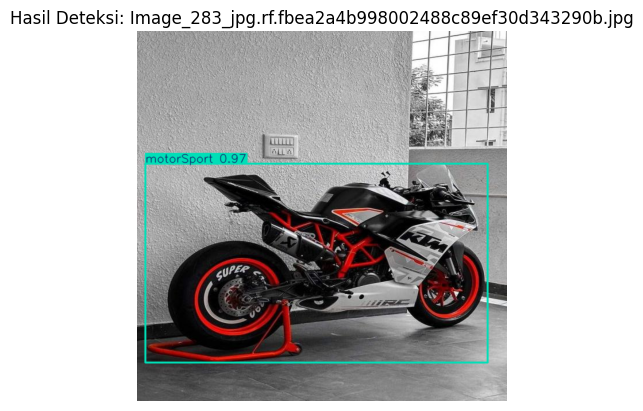

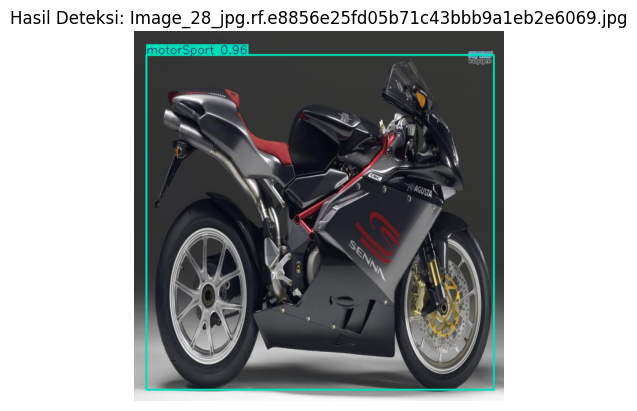

...

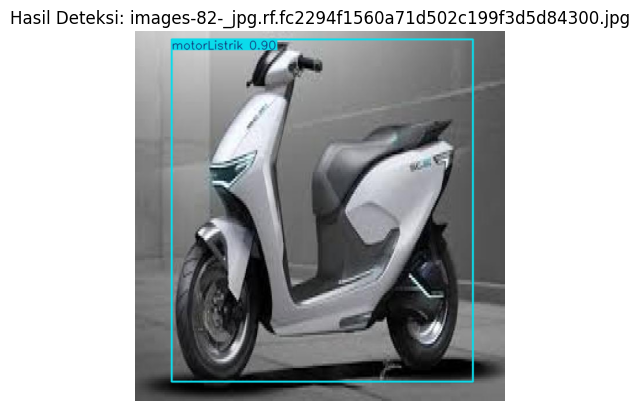

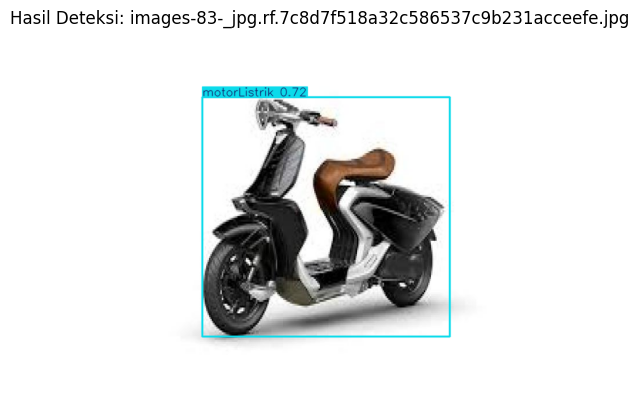

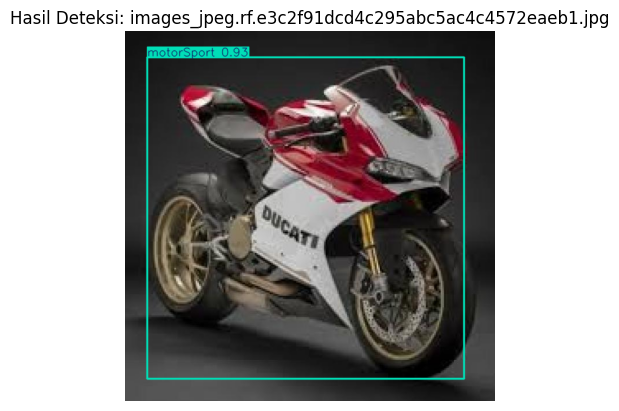

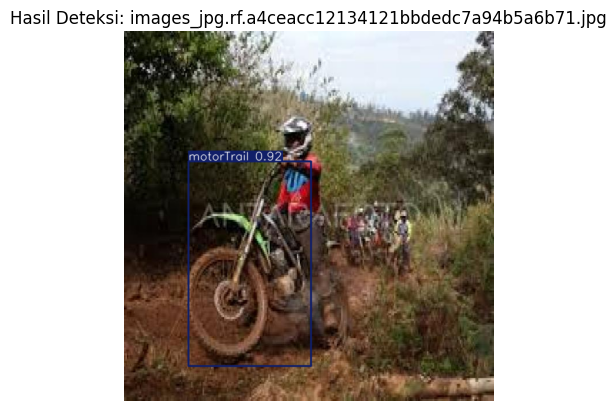

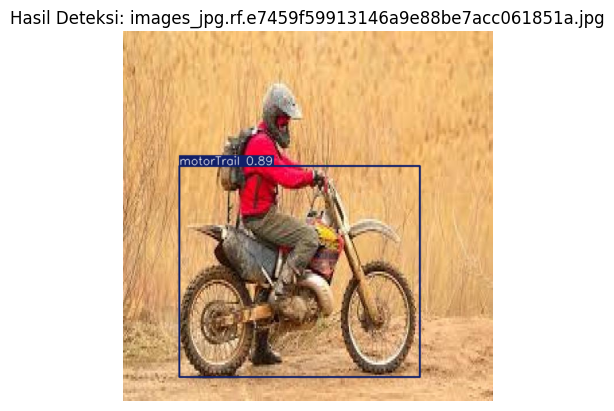

In [9]:
from ultralytics import YOLO
import os
import cv2
import matplotlib.pyplot as plt

# Load model hasil training
model = YOLO("runs/detect/motorcycle_rf_train/weights/best.pt")

# Path ke folder test Roboflow
test_folder = os.path.join(dataset.location, "test/images")

# Buat folder output khusus untuk hasil deteksi
output_dir = "test_results"
os.makedirs(output_dir, exist_ok=True)

# Lakukan inference untuk semua gambar di folder test
results = model(test_folder, conf=0.25, save=False)  # save=False karena kita simpan manual

# Loop hasil dan simpan
for i, result in enumerate(results):
    # Nama file input
    input_path = result.path
    filename = os.path.basename(input_path)

    # Gambar hasil prediksi (dengan bounding box)
    img_with_boxes = result.plot()

    # Path output hasil gambar
    output_path = os.path.join(output_dir, filename)

    # Simpan hasil deteksi
    cv2.imwrite(output_path, img_with_boxes)

    # Tampilkan (opsional)
    plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
    plt.title(f"Hasil Deteksi: {filename}")
    plt.axis('off')
    plt.show()
